# Hazard Predictions

## The Challenge 

### Automatic Hazard Detection  on Transverse Cirrus Bands (TCB)
#### Hurricanes | Tunderstorms | Atmospheric jets

TCBs are bands of clouds oriented perpendicular to the atmospheric flow in which they are embedded. TCBs are often an indicator of strong turbulence and often associated with severe weather such as hurricanes and thunderstorms or atmospheric jets.

Transverse Cirrus Bands Data: s3://impact-datashare/transverse_bands/
        
        

### Imports

In [1]:
!conda activate skyfolks-env

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
plt.rcParams["figure.figsize"] = (15, 10)
plt.rcParams["figure.dpi"] = 125
plt.rcParams["font.size"] = 14
plt.rcParams['font.family'] = ['sans-serif']
plt.rcParams['font.sans-serif'] = ['DejaVu Sans']
plt.style.use('ggplot')
sns.set_style("whitegrid", {'axes.grid': False})
plt.rcParams['image.cmap'] = 'gray' # grayscale looks better

In [2]:
from pathlib import Path
import numpy as np
import pandas as pd
import os
from skimage.io import imread as imread
from skimage.util import montage
from PIL import Image
montage_rgb = lambda x: np.stack([montage(x[:, :, :, i]) for i in range(x.shape[3])], -1)
from skimage.color import label2rgb

###  Reading Data

REUSE dataset generator and augmentations from Examples
Link: https://github.com/nasa/spaceapps-phenomena_detection/blob/dev/examples/ml_model_demo_1.ipynb

Apply the logic to the Hurricane Dataset | Transverse Cirrus Bands (TCB)


This is used to push subsets of input images in memory for Keras so that there is no out of memory error during Training phase

In [3]:
montage_rgb = lambda x: np.stack([montage(x[:, :, :, i]) for i in range(x.shape[3])], -1)

image_dir = Path('.') / 'data' / 'transverse_bands'
mapping_file = Path('.') / 'data' / 'list_of_images.json'
image_df = pd.read_json(mapping_file)

image_df['is_hurricane'] = image_df['path'].map(lambda x: "yes" in x) 

image_df.sample(3)


,path,is_hurricane
4781,data/transverse_bands/no/not_bands1854.jpg,False
5046,data/transverse_bands/no/not_bands2123.png,False
2924,data/transverse_bands/no/77_18-2011-07-17-6-0....,False


In [4]:
image_df.describe()

,path,is_hurricane
count,6802,6802
unique,6801,2
top,data/transverse_bands/yes/0_11-2011-07-17-6-0....,False
freq,2,4901


In [5]:
image_df.head()

,path,is_hurricane
0,data/transverse_bands/yes/0_11-2011-07-17-6-0....,True
1,data/transverse_bands/yes/0_11-2011-07-17-6-0....,True
10,data/transverse_bands/yes/12_9-2010-05-12-6-0....,True
100,data/transverse_bands/yes/38_11-2017-01-08-6-0...,True
1000,data/transverse_bands/yes/bands0844.png,True


In [6]:
print(image_df['path'].map(lambda x: Path(x).exists()).value_counts()) # make sure everything is found

True    6802
Name: path, dtype: int64


In [7]:
image_df['is_hurricane'].value_counts()

False    4901
True     1901
Name: is_hurricane, dtype: int64

In [8]:
from sklearn.model_selection import train_test_split
train_df = image_df
train_df.reset_index(inplace=True)
print(train_df.shape[0], 'training images')

6802 training images


In [9]:
image_df.index

RangeIndex(start=0, stop=6802, step=1)

In [27]:
train_x_vec = np.stack(train_df[['id', 'path']], 0)
train_y_vec = np.stack(train_df['is_hurricane'], 0)
print(train_x_vec.shape, '->', train_y_vec.shape)

(2,) -> (6802,)


In [10]:
image_df.insert(0, 'id', image_df.index)

In [11]:
image_df

,id,index,path,is_hurricane
0,0,0,data/transverse_bands/yes/0_11-2011-07-17-6-0....,True
1,1,1,data/transverse_bands/yes/0_11-2011-07-17-6-0....,True
2,2,10,data/transverse_bands/yes/12_9-2010-05-12-6-0....,True
3,3,100,data/transverse_bands/yes/38_11-2017-01-08-6-0...,True
4,4,1000,data/transverse_bands/yes/bands0844.png,True
...,...,...,...,...
6797,6797,995,data/transverse_bands/yes/bands0839.jpg,True
6798,6798,996,data/transverse_bands/yes/bands0840.png,True
6799,6799,997,data/transverse_bands/yes/bands0841.png,True
6800,6800,998,data/transverse_bands/yes/bands0842.jpg,True


In [12]:
from PIL import Image

def get_image_pixels(imagePath):
    im = Image.open(imagePath, 'r')
    width, height = im.size
    pixel_values = list(im.getdata())

    return pixel_values

In [ ]:
image_df['image_rgb'] = [ get_image_pixels(x) for x in image_df['path'] ]

In [3]:
image_df.head()

NameError: name 'image_df' is not defined

### Create color Column

In [4]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
plt.rcParams["figure.figsize"] = (6, 6)
plt.rcParams["figure.dpi"] = 200
plt.rcParams["font.size"] = 14
plt.rcParams['font.family'] = ['sans-serif']
plt.rcParams['font.sans-serif'] = ['DejaVu Sans']
plt.style.use('ggplot')
sns.set_style("whitegrid", {'axes.grid': False})
plt.rcParams['image.cmap'] = 'viridis'

In [5]:
from pathlib import Path
import pandas as pd
import numpy as np
from PIL import Image
from skimage.io import imread
from skimage.util import montage
from tqdm import tqdm
tqdm.pandas() # hack progressbars into pandas
montage_rgb = lambda x, **kwargs: np.stack([montage(x[:, :, :, i], **kwargs) for i in range(x.shape[3])], -1)

C:\ProgramData\Anaconda3\lib\site-packages\tqdm\std.py:668: FutureWarning:

The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version



In [7]:
satellite_dir = Path('data/transverse_bands')
image_df = pd.DataFrame({'path': list(satellite_dir.glob('**/*.jp*g'))})
image_df.sample(3)

,path
194,data\transverse_bands\no\19_12-2017-01-29-6-0....
2958,data\transverse_bands\no\not_bands2505.jpg
1167,data\transverse_bands\no\not_bands0164.jpg


In [19]:
image_df['path'][0].__str__()

'data\\transverse_bands\\no\\0_12-2011-07-17-6-0.56.jpg'

In [22]:
image_df['is_hurricane'] = image_df['path'].map(lambda x: "yes" in x.__str__()) 
# image_df['data_split'] = image_df['path'].map(lambda x: x.parent.parent.stem)
# image_df['location'] = image_df['path'].map(lambda x: x.stem)
# image_df['lat'] = image_df['location'].map(lambda x: float(x.split('_')[0]))
# image_df['lon'] = image_df['location'].map(lambda x: float(x.split('_')[-1]))
image_df.sample(3)

,path,is_hurricane
4502,data\transverse_bands\yes\bands0568.jpg,True
3022,data\transverse_bands\no\not_bands2589.jpg,False
2412,data\transverse_bands\no\not_bands1783.jpg,False


ValueError: all input arrays must have the same shape

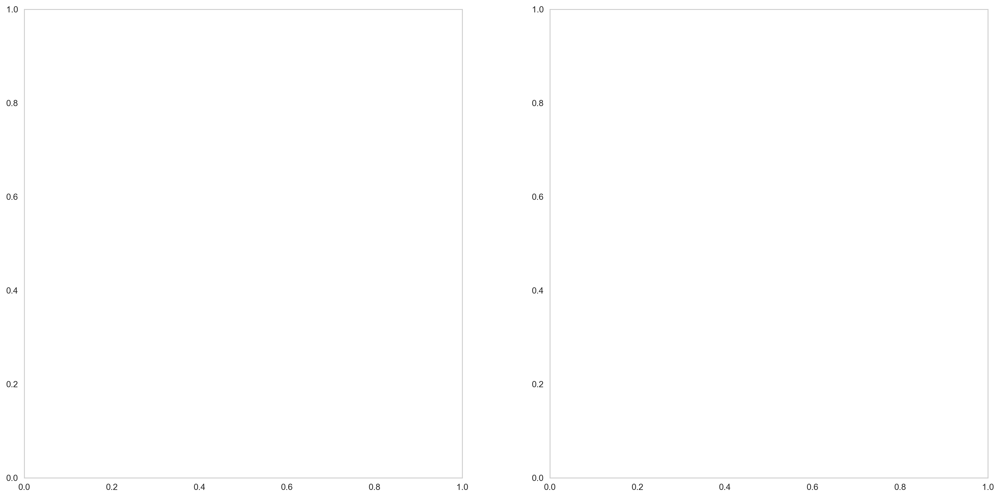

In [28]:
## Image Preview

fig, m_axs = plt.subplots(1, 2, figsize=(20, 10))
for c_ax, (c_cat, c_rows) in zip(m_axs, image_df.groupby(['is_hurricane'])):
    img_stack = np.stack(c_rows.sample(50)['path'].map(imread), 0)
    c_ax.imshow(montage_rgb(img_stack))
    c_ax.set_title(c_cat)
    c_ax.axis('off')

In [33]:
image_df.groupby(['is_hurricane']).size()

is_hurricane
False    4037
True     1107
dtype: int64

In [34]:
for c_ax, (c_cat, c_rows) in zip(m_axs.flatten(), image_df.groupby(['is_hurricane'])):
    img_stack = np.stack(c_rows.sample(20)['path'].map(imread), 0)
    c_ax.imshow(montage_rgb(img_stack))
    c_ax.set_title(c_cat)
    c_ax.axis('off')

ValueError: all input arrays must have the same shape

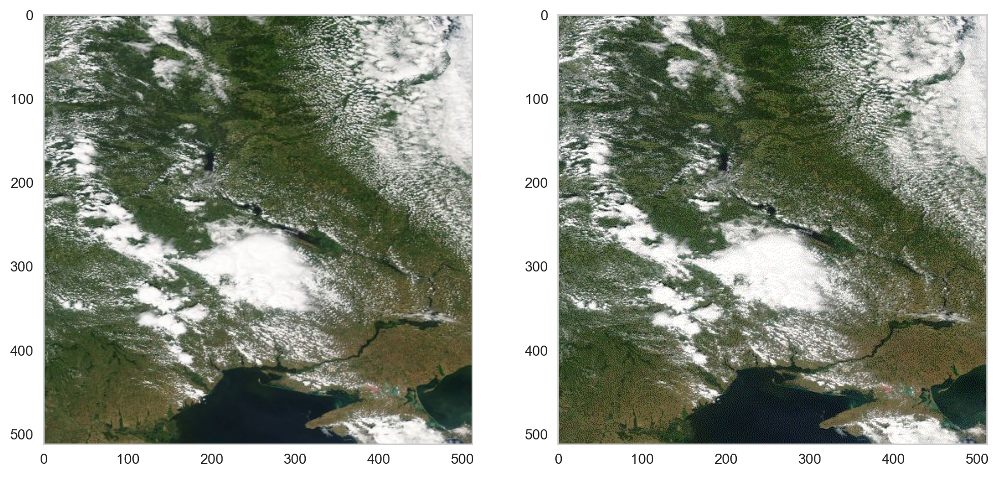

In [50]:
test_image = Image.open(image_df['path'].iloc[2739]) # normal image
# convert to 8bit color (animated GIF) and then back
web_image = test_image.convert('P', palette='WEB', dither=None)
few_color_image = web_image.convert('RGB')
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
ax1.imshow(test_image)
ax2.imshow(few_color_image)

In [51]:
print('Unique colors before', len(set([tuple(rgb) for rgb in np.array(test_image).reshape((-1, 3))])))
print('Unique colors after', len(set([tuple(rgb) for rgb in np.array(few_color_image).reshape((-1, 3))])))

Unique colors before 39088
Unique colors after 54


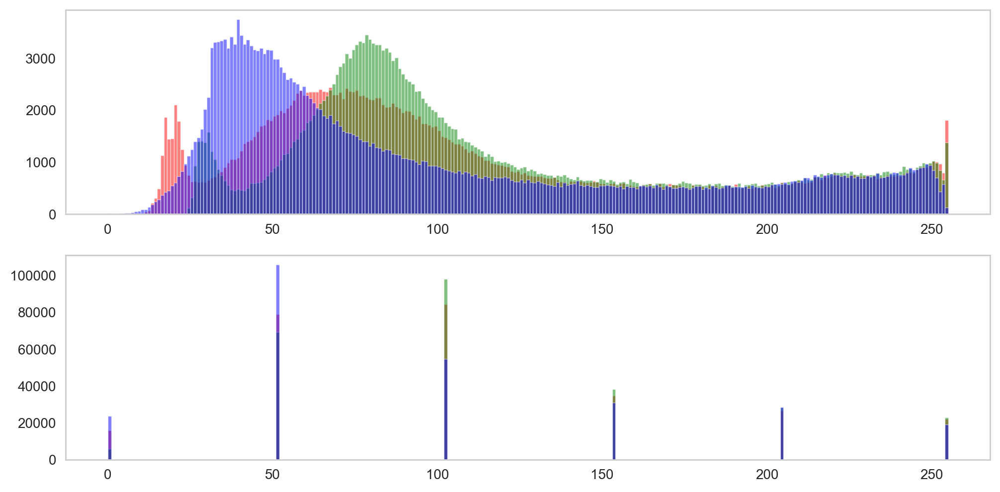

In [52]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 6))
for c_channel, c_name in enumerate(['red', 'green', 'blue']):
    ax1.hist(np.array(test_image)[:, :, c_channel].ravel(), 
             color=c_name[0], 
             label=c_name, 
             bins=np.arange(256), 
             alpha=0.5)
    ax2.hist(np.array(few_color_image)[:, :, c_channel].ravel(), 
             color=c_name[0], 
             label=c_name, 
             bins=np.arange(256), 
             alpha=0.5)

In [53]:
idx_to_color = np.array(web_image.getpalette()).reshape((-1, 3))/255.0

Text(0, 0.5, 'Pixel Count')

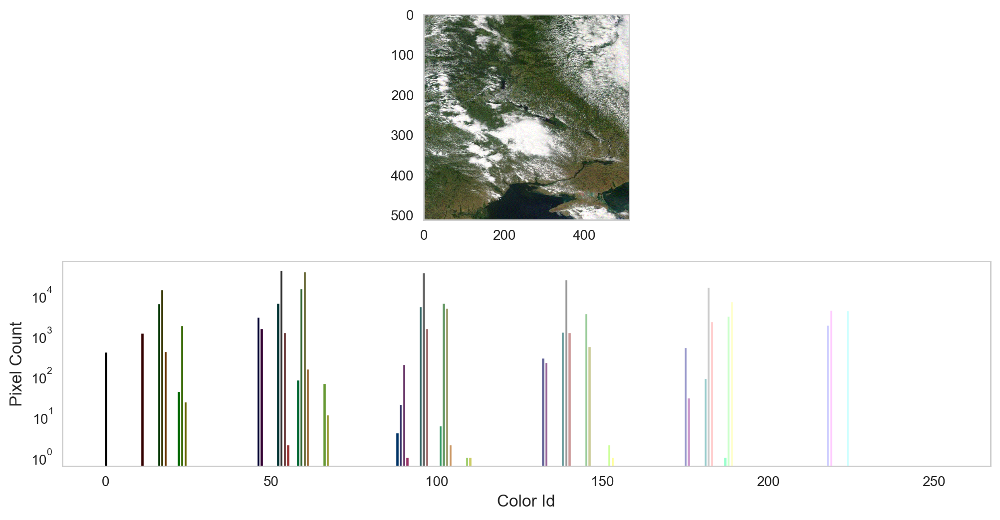

In [54]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 6))
ax1.imshow(few_color_image)
counts, bins = np.histogram(web_image, bins=np.arange(256))
for i in range(counts.shape[0]):
    ax2.bar(bins[i], counts[i], color=idx_to_color[i])
ax2.set_yscale('log')
ax2.set_xlabel('Color Id')
ax2.set_ylabel('Pixel Count')

In [55]:
def color_count_feature(in_path):
    raw_image = Image.open(in_path) 
    web_image = raw_image.convert('P', palette='WEB', dither=None)
    counts, bins = np.histogram(np.array(web_image).ravel(), bins=np.arange(256))
    return counts*1.0/np.prod(web_image.size) # normalize output

In [56]:
%%time
image_df['color_features'] = image_df['path'].progress_map(color_count_feature)

100%|██████████████████████████████████████████████████████████████████████████████| 5144/5144 [07:41<00:00, 11.14it/s]

Wall time: 7min 41s


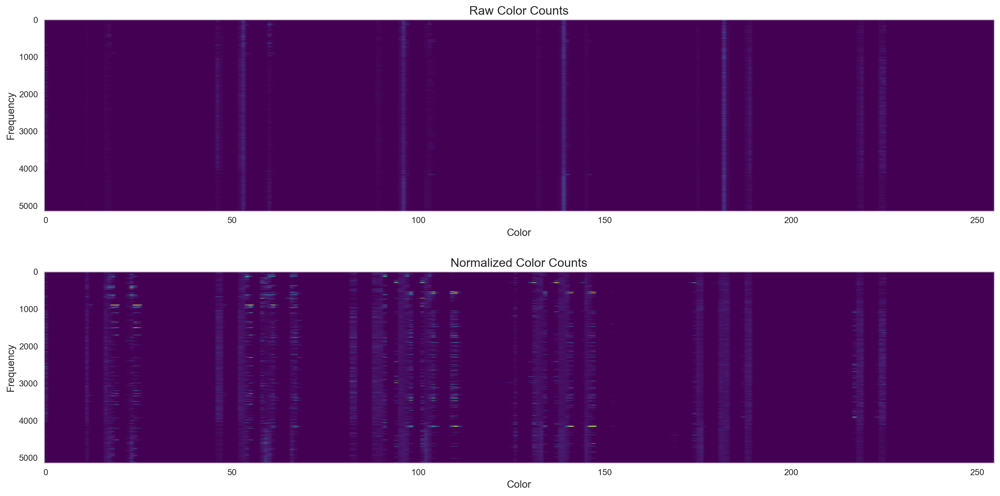

In [57]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(20, 10))
combined_features = np.stack(image_df['color_features'].values, 0)
ax1.imshow(combined_features)
ax1.set_title('Raw Color Counts')
ax1.set_xlabel('Color')
ax1.set_ylabel('Frequency')
ax1.set_aspect(0.01)
color_wise_average = np.tile(np.mean(combined_features, 0, keepdims=True), (combined_features.shape[0], 1)).clip(1/(128*128), 1)
ax2.imshow(combined_features/color_wise_average, vmin=0.05, vmax=20)
ax2.set_title('Normalized Color Counts')
ax2.set_xlabel('Color')
ax2.set_ylabel('Frequency')
ax2.set_aspect(0.01)


In [58]:
from sklearn.decomposition import PCA
xy_pca = PCA(n_components=2)
xy_coords = xy_pca.fit_transform(combined_features)
image_df['x'] = xy_coords[:, 0]
image_df['y'] = xy_coords[:, 1]

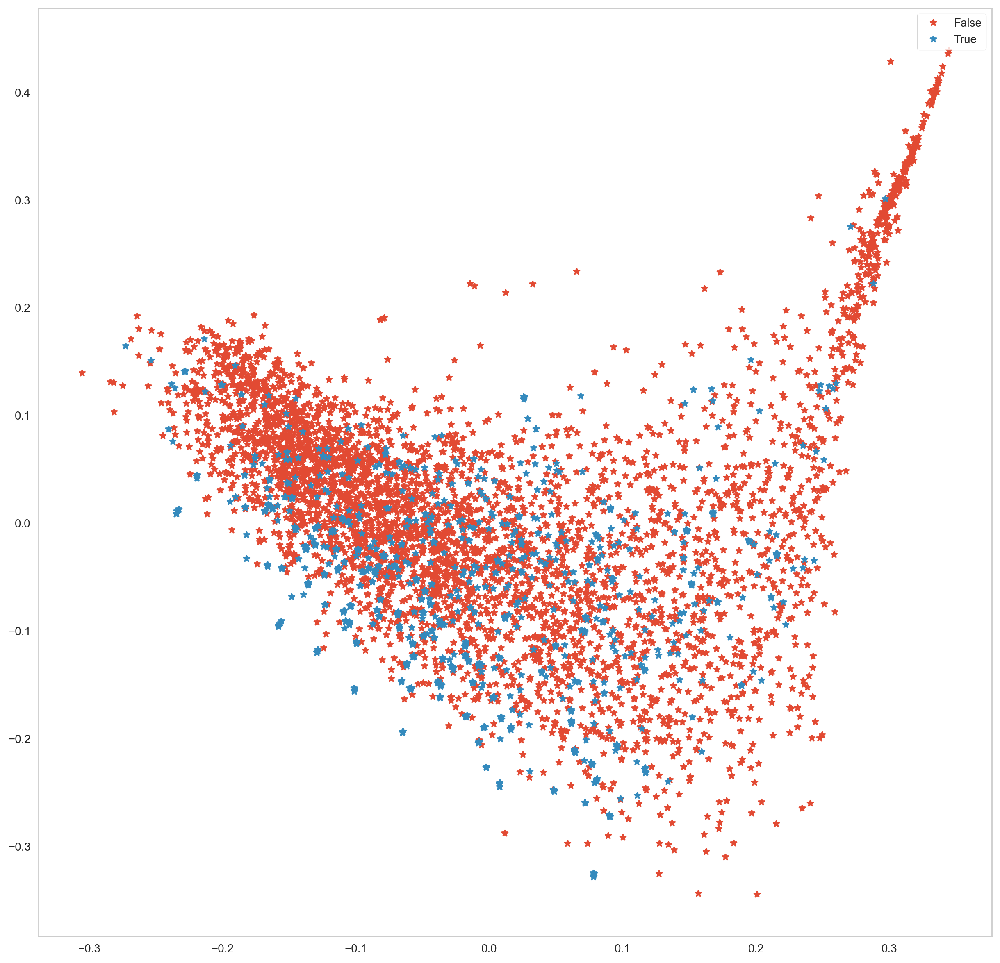

In [59]:
fig, ax1 = plt.subplots(1,1, figsize=(15, 15))
for c_group, c_row in image_df.groupby('is_hurricane'):
    ax1.plot(c_row['x'], c_row['y'], '*', label=c_group)
ax1.legend()

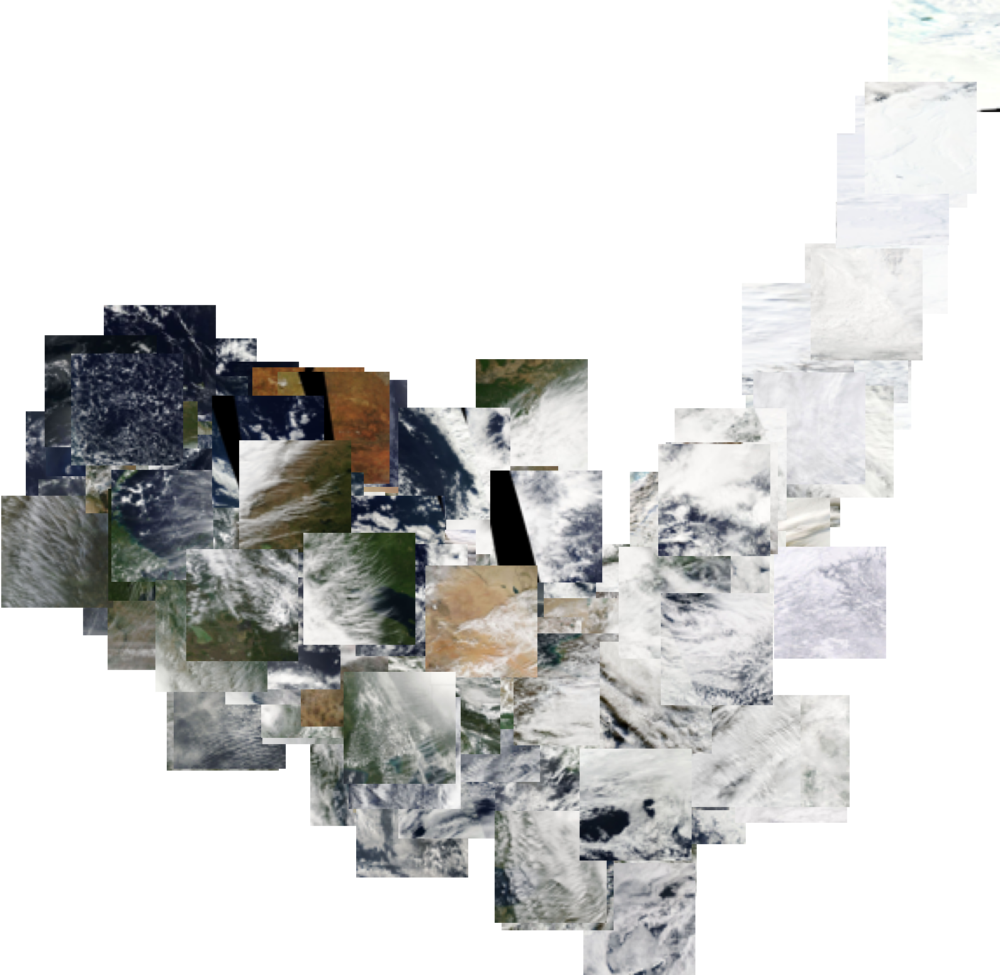

In [60]:
def show_xy_images(in_df, image_zoom=1):
    fig, ax1 = plt.subplots(1,1, figsize=(10, 10))
    artists = []
    for _, c_row in in_df.iterrows():
        c_img = Image.open(c_row['path']).resize((64, 64))
        img = OffsetImage(c_img, zoom=image_zoom)
        ab = AnnotationBbox(img, (c_row['x'], c_row['y']), xycoords='data', frameon=False)
        artists.append(ax1.add_artist(ab))
    ax1.update_datalim(in_df[['x', 'y']])
    ax1.autoscale()
    ax1.axis('off')
show_xy_images(image_df.sample(200))

In [61]:
image_df['path'] = image_df['path'].map(str) # saving pathlib objects causes problems
image_df.to_json('color_features.json')

In [62]:
image_df.sample(3)

,path,is_hurricane,color_features,x,y
2931,data\transverse_bands\no\not_bands2474.jpg,False,"[0.04657745361328125, 0.0, 0.0, 0.0, 0.0, 0.0,...",-0.079220,0.009223
4336,data\transverse_bands\yes\bands0253.jpg,True,"[0.0002288818359375, 0.0, 0.0, 0.0, 0.0, 0.0, ...",-0.064956,-0.193448
3873,data\transverse_bands\no\not_bands3687.jpg,False,"[0.004955291748046875, 0.0, 0.0, 0.0, 0.0, 0.0...",-0.067029,-0.044355


In [77]:
image_df['data_split'] = 'train_another'
image_df['data_split'].value_counts()

train_another    5144
Name: data_split, dtype: int64

In [78]:
from sklearn.model_selection import train_test_split
train_df = image_df.query('data_split=="train_another"')
train_df.reset_index(inplace=True)
print(train_df.shape[0], 'training images')

5144 training images


In [79]:
train_x_vec = np.stack(train_df['color_features'].values, 0)
train_y_vec = np.stack(train_df['is_hurricane'], 0)
print(train_x_vec.shape, '->', train_y_vec.shape)

(5144, 255) -> (5144,)


In [89]:
from sklearn.metrics import roc_auc_score, roc_curve, accuracy_score
def show_model_results(in_model, use_split=None, plot_type='swarm'):
    fig, m_axs = plt.subplots(4, 2, figsize=(15, 30))
    m_axs = m_axs.flatten()
    all_rows = []
    ax1 = m_axs[0]
    
    if use_split is None:
        cur_df = image_df.copy()
    else:
        cur_df = image_df.query('data_split=="{}"'.format(use_split)) 
    
    for c_split, example_df in cur_df.groupby('data_split'):
        example_df = example_df.reset_index()
        x_vec = np.stack(example_df['color_features'].values, 0)
        y_vec = np.stack(example_df['is_hurricane'], 0)

        valid_pred = in_model.predict(x_vec)
        tpr, fpr, _ = roc_curve(y_vec[:], valid_pred[:])
        auc = roc_auc_score(y_vec[:], valid_pred[:])
        acc = accuracy_score(y_vec[:], valid_pred[:]>0.5)
        ax1.plot(tpr, fpr, '.-', label='{}, AUC {:0.2f}, Accuracy: {:2.0%}'.format(c_split, auc, acc))
        all_rows += [pd.DataFrame({'class': y_vec[:], 'prediction': np.clip(valid_pred[:], 0, 1), 'type': 'is_hurricane', 
                                  'split': c_split})]
    
    c_all_df = pd.concat(all_rows)
        
    # show example images
    ax1.legend()
    for (_, c_row), (c_ax) in zip(
        example_df.sample(m_axs.shape[0]).iterrows(), 
                               m_axs[1:-1]):
        
        c_ax.imshow(imread(c_row['path']))
        t_yp = in_model.predict(np.expand_dims(c_row['color_features'], 0))
        c_ax.set_title('Class: {}\n Is Hurricane Prediction: {:2.2%}'.format(c_row['is_hurricane'], t_yp[0]))
        c_ax.axis('off')
        
        t_y = np.array(c_row['is_hurricane'])
    
    # nice dataframe of output
    
    ax1 = m_axs[-1]
    if plot_type=='swarm':
        # prevent overplotting
        sns.swarmplot(data=c_all_df.sample(500) if c_all_df.shape[0]>1000 else c_all_df,
                      hue='class', 
                      y='prediction', 
                      x='type', 
                      size=2.0, 
                      ax=ax1)
    elif plot_type=='box':
        sns.boxplot(data=c_all_df, hue='class', y='prediction', x='type', ax=ax1)
    elif plot_type=='violin':
        sns.violinplot(data=c_all_df, hue='class', y='prediction', x='type', ax=ax1)
    ax1.set_ylim(-0.05, 1.05)
    return c_all_df

In [90]:
from sklearn.neighbors import KNeighborsRegressor
knn = KNeighborsRegressor(n_neighbors=1)
knn.fit(train_x_vec, train_y_vec)

KNeighborsRegressor(n_neighbors=1)

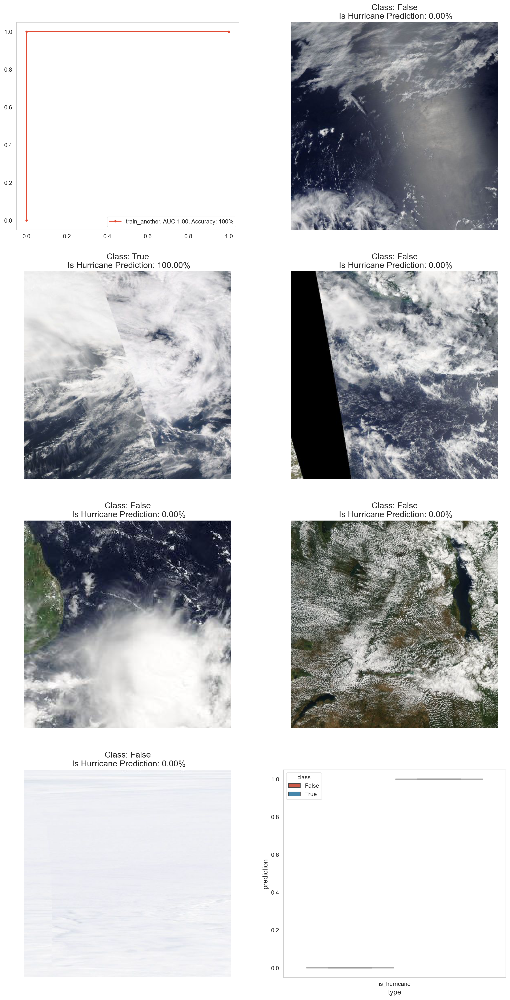

In [91]:
show_model_results(knn, None, plot_type='box');

## Dig deeper

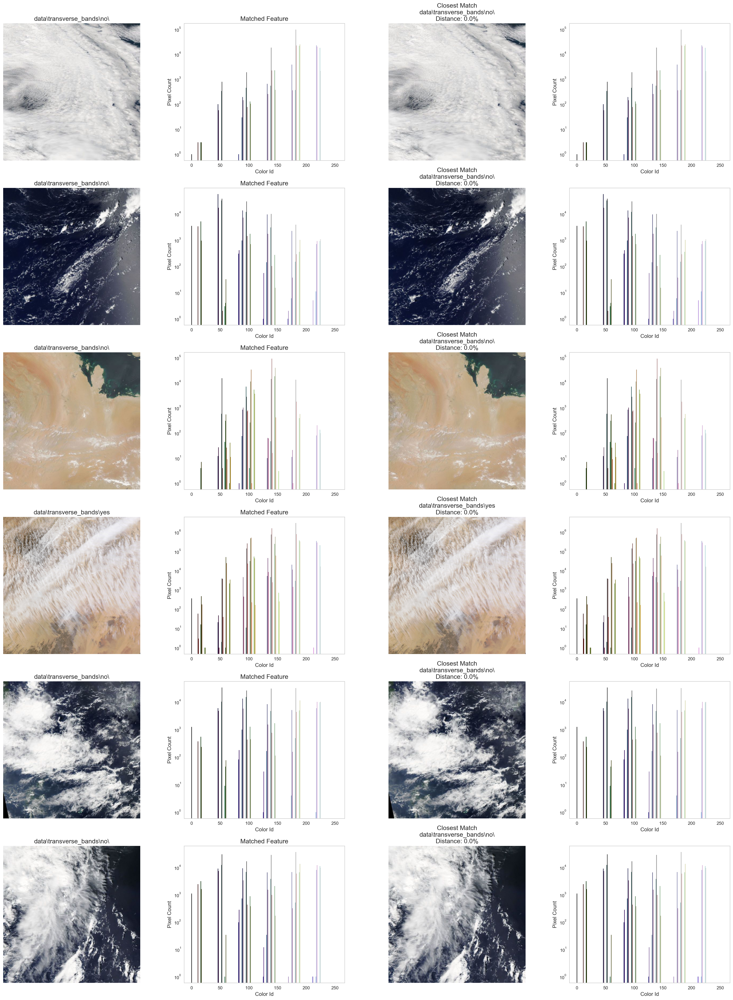

In [93]:
fig, m_axs = plt.subplots(6, 4, figsize=(30, 40))
dummy_web_image = Image.new(size=(1,1), mode='RGB').convert('P', palette='web')

for (c_ax, c_feat_ax, d_ax, d_feat_ax), (_, c_row) in zip(m_axs, 
                            image_df.sample(m_axs.shape[0], random_state=2018).iterrows()):
    
    query_img = Image.open(c_row['path'])
    idx_to_color = np.array(query_img.convert('P', palette='web').getpalette()).reshape((-1, 3))/255.0
    c_ax.imshow(query_img)
    c_ax.set_title(c_row['path'][:25])
    c_ax.axis('off')
    counts, bins = np.histogram(np.ravel(query_img.convert('P', palette='web')), 
                                bins=np.arange(256))
    
    for i in range(counts.shape[0]):
        c_feat_ax.bar(bins[i], counts[i], color=idx_to_color[i], edgecolor='k', linewidth=0.1)
    c_feat_ax.set_yscale('log')
    c_feat_ax.set_xlabel('Color Id')
    c_feat_ax.set_ylabel('Pixel Count')
    c_feat_ax.set_title('Feature Vector')
    
    dist, idx = knn.kneighbors(np.expand_dims(c_row['color_features'], 0))
    m_row = train_df.iloc[idx[0][0]]
    matched_img = Image.open(m_row['path'])
    
    d_ax.imshow(matched_img)
    d_ax.set_title('Closest Match\n{}\nDistance: {:2.1%}'.format(m_row['path'][:25], dist[0][0]))
    d_ax.axis('off')
    
    counts, bins = np.histogram(np.ravel(matched_img.convert('P', palette='web')), 
                                bins=np.arange(256))
    
    for i in range(counts.shape[0]):
        d_feat_ax.bar(bins[i], counts[i], color=idx_to_color[i], edgecolor='k', linewidth=0.1)
    d_feat_ax.set_yscale('log')
    d_feat_ax.set_xlabel('Color Id')
    d_feat_ax.set_ylabel('Pixel Count')
    c_feat_ax.set_title('Matched Feature')

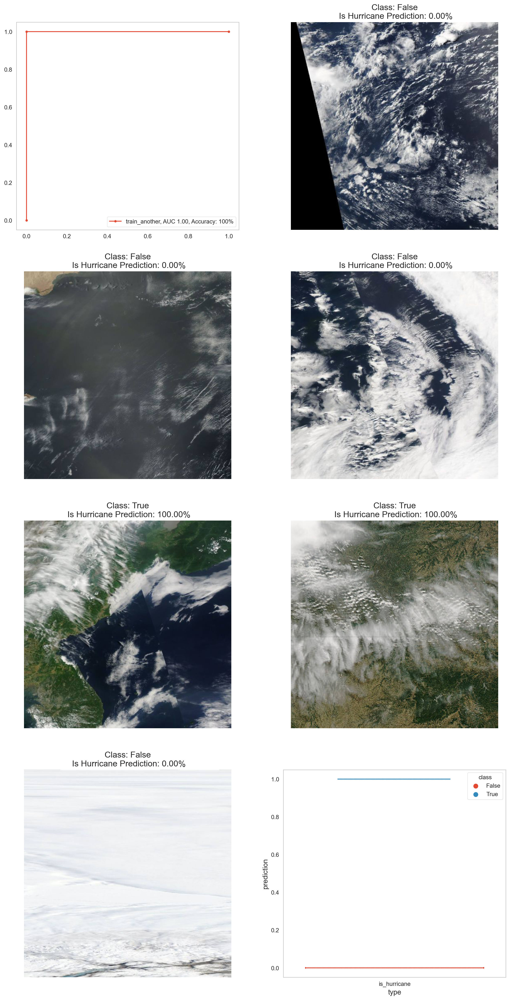

In [94]:
show_model_results(knn);

In [96]:
train_df.iloc[0]

level_0                                                           0
index                                                             0
path              data\transverse_bands\no\0_12-2011-07-17-6-0.5...
is_hurricane                                                  False
color_features    [0.04955291748046875, 0.0, 0.0, 0.0, 0.0, 0.0,...
x                                                         -0.131453
y                                                         0.0295439
data_split                                            train_another
Name: 0, dtype: object

###  Build Model

#### Build a simple model with kNeighborsRegressor

###  Test and Predict

In [102]:
train_x_vec[0]

array([4.95529175e-02, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 2.06985474e-02,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       3.42254639e-02, 3.28826904e-03, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 1.77059174e-01, 3.07998657e-02,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       5.90209961e-02, 8.93058777e-02, 0.00000000e+00, 0.00000000e+00,
      

In [107]:
train_x_vec.shape()

TypeError: 'tuple' object is not callable

In [101]:
train_y_vec

array([False, False, False, ...,  True,  True,  True])

In [104]:
knn.predict(train_x_vec[0]);

TypeError: predict() takes 2 positional arguments but 3 were given

###  Save Model

### Reload model

# HAZAR-PREDICTION-SERVICE

##### Logic steps

1. Expose Endpoint using Flask

2. Receive Request in JSON

3. Call MODIS to retrieve image for X,Y

4. Run Image by previous Model

5. Return Results in JSON
